# Pokemon Generative Adversarial Network : PokeGAN

# What is a GAN

Generative Adversarial Networks are neural network made to generate data as closer as possible to real data.

To do so a GAN is compose of two neural networks :

* A Generator 

* A Discriminator

These two neural networks will compete with each other  : 
* The **Discriminator** is trying to detect fake samples appart from real one
* The **Generator** is trying to create fake samples that will deceive the Discriminator

And this is how we got a GAN , both networks will be trained at the same time.

![title](GAN.png)

### Why do we train them at the same time ? Why don't we use a Discriminator already strong ?

Let's imagine you are a Generator and you don't know a thing about the world , then I ask you to draw something .
Then you start drawing something totally random since you don't have any knowledge about the world .
I am the Discriminator . You don't know but I want you to draw a picasso and I won't give you any information . I'll just give you a feedback about either your work is or not a picasso ! 
Obviously if I'm an expert I'll just say your work is terrible since you can't possibly draw a picasso drawing randomly , all your work is going inside the garbadge and since since you don't get any good feedback . you'll never learn a thing .

Then let's change the Discriminator , let's say I too don't know anything about the world . I still want you too draw a picasso , but I'm not able to recognize one of them . Then I'll just have a quick glance at a picasso before checking your work . Therefore I'll be able to understand some really simple pattern which make a picasso.Like some wavely like lines. 
Now drawing randomly you'll be able to draw these simply wavely lines and each time you do so you'll get a positive feedback making you understand that these lines are usefull . And therefore you won't just draw randomly anymore, but you'll add these lines in your drawings and keep adding more complex stuff . Leading you after a lot of iteration to a perfect picasso !

### GAN never overfit !

Since the generator is never seeing any sample from the dataset it won't ever be able to overfit over them 

### The challenge of using GAN

GAN are really difficult to train by the nature of the model . Since the model are competing we need to keep a balance between them . If either one of the net is overperforming the other you won't get any result !

If the Discriminator become too strong the generator won't be able to learn anything anymore , and if the discriminator is too weak the generator will create really simple samples but strong enough to trick the weak discriminaror and we will get result far from the objective

# Implementation

The architecture of the model will be inspired from the DCGAN paper : https://arxiv.org/pdf/1511.06434.pdf
Since it's really difficult to have good result with GAN we'll stay as close as possible from the paper implementation

To implement this GAN we'll use the Deep Learning library from Facebook : pyTorch

## Data Processing

First let's create the function we'll use to manager our data ( load , preprocess etc ...)

In [1]:
from tqdm import tqdm
from PIL import Image
import numpy as np
from skimage import color 

# Normalize the img between -1 and 1
# Also I decided to use the Lab space instead of the RGB one
def numpy_normalize(img):
    img = color.rgb2lab(img / 255.0)
    L = (img[: , : , 0] / 100.0 - 0.5) * 2.0
    a = img[: , : , 1] / 128.0
    b = img[: , : , 2] / 128.0
    img = np.stack((L , a , b) ,axis = 2)
    #img = (img - 0.5) * 2.0
    return img

# Perform the inverse operation of numpy_normalize
def numpy_denormalize(img):
    #img = img / 2.0 + 0.5
    L = (img[: , : , 0] / 2.0 + 0.5) * 100.0
    a = img[: , : , 1] * 128.0
    b = img[: , : , 2] * 128.0
    
    img = np.stack((L , a , b) , axis=2)
    img = color.lab2rgb(img)
    return img
            
def load_image( infilename , size=(128,128)) :
    img = Image.open( infilename )
    img.load()
    img = img.resize(size)
    data = np.asarray( img, dtype="int32" )
    return data

def load_dataset(dataset , img_size=(128,128)):
    samples = []
    labels = []
    for pokemon in tqdm(dataset):
        image = load_image(pokemon , img_size)
        normalized_image = numpy_normalize(image)
        samples.append( normalized_image )
    return np.array(samples)


    

Let's test our dicriminator

## Generator

![title](dcgan_generator.png)

Here the architecture of the Generator 

We use ConvTranspose to perform a deconvolution-like operation , allowing us to increase the dimension of the image

In [2]:
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset as TorchDataset
import torch

class GeneratorNet(nn.Module):
    def __init__(self , z_dim):
        super(GeneratorNet, self).__init__()
        self.input_conv = nn.ConvTranspose2d(100, 512, 4, stride=1 ,  bias=False)
        self.deconv_1 = nn.ConvTranspose2d(512 , 256 , 4 , stride=2 , padding=1 ,bias=False)
        self.deconv_2 = nn.ConvTranspose2d(256 , 128 , 4 , stride=2 , padding=1 ,bias=False)
        self.deconv_3 = nn.ConvTranspose2d(128 , 64 , 4 , stride=2 , padding=1 ,bias=False)
        self.deconv_4 = nn.ConvTranspose2d(64 , 3 , 4 , stride=2 , padding=1 ,bias=False)
        
        self.bn1 = nn.BatchNorm2d(512)
        self.bn2 = nn.BatchNorm2d(256)
        self.bn3 = nn.BatchNorm2d(128)
        self.bn4 = nn.BatchNorm2d(64)
        
    def forward(self , x):
        x = F.relu(self.bn1(self.input_conv(x)))
        x = F.relu(self.bn2(self.deconv_1(x)))
        x = F.relu(self.bn3(self.deconv_2(x)))
        x = F.relu(self.bn4(self.deconv_3(x)))
        x = torch.tanh(self.deconv_4(x))
        
        return x
    
def generator_net(z_dim):
    generator = GeneratorNet(z_dim)
    optimizer = optim.Adam(generator.parameters(), lr=0.0002 , betas=(0.5 , 0.999))
    
    return generator.cuda() , optimizer

## Discriminator

![title](disc_gen.png)

The discriminator have the opposite architecture

In [3]:
class DiscriminatorNet(nn.Module):
    def __init__(self , input_shape):
        super(DiscriminatorNet, self).__init__()
        self.conv_1 = nn.Conv2d(3 , 64 , 4 , stride=2 , padding=1 ,bias=False)
        self.conv_2 = nn.Conv2d(64 , 128 , 4 , stride=2 , padding=1 ,bias=False)
        self.conv_3 = nn.Conv2d(128 , 256 , 4 , stride=2 , padding=1 ,bias=False)
        self.conv_4 = nn.Conv2d(256 , 512 , 4 , stride=2 , padding=1 ,bias=False)
        
        self.bn1 = nn.BatchNorm2d(64)
        self.bn2 = nn.BatchNorm2d(128)
        self.bn3 = nn.BatchNorm2d(256)
        self.bn4 = nn.BatchNorm2d(512)
        
        flatten_size = 4 * 4 * 512
        self.fc1 = nn.Linear(flatten_size, 1)
        
    def forward(self , x):
        x = F.leaky_relu(self.bn1(self.conv_1(x)) , 0.2)
        x = F.leaky_relu(self.bn2(self.conv_2(x)) , 0.2)
        x = F.leaky_relu(self.bn3(self.conv_3(x)) , 0.2)
        x = F.leaky_relu(self.bn4(self.conv_4(x)) , 0.2)
        
        x = x.view(x.shape[0] , -1)
        x = F.sigmoid(self.fc1(x))
        
        return x
    
def discriminator_net(input_shape):
    discriminator = DiscriminatorNet(input_shape)
    criterion = nn.BCELoss()
    optimizer = optim.Adam(discriminator.parameters() , lr=0.0002 , betas=(0.5 , 0.999))
    
    return discriminator.cuda() , optimizer , criterion.cuda()

### Weight Initializer

In accordance with the paper we should initialize our layers using a normal law with a std = 0.02

In [4]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

### Training

In [5]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def show_img(img):
    plt.figure()
    imgplot = plt.imshow(img)

In [6]:
import glob

# Let's load the dataset of real image
# Here the dataset contain images of pokemon

DATASET_LOCATION = "pokemon/*"
IMG_SIZE = (64 , 64)
dataset_paths = glob.glob(DATASET_LOCATION)
data = load_dataset(dataset_paths , IMG_SIZE)


100%|██████████| 8190/8190 [01:29<00:00, 91.21it/s] 


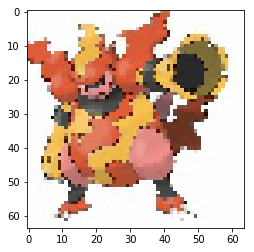

In [7]:
#Let's have a look of the loaded data 

index = np.random.randint(0 , data.shape[0] - 1)
show_img(numpy_denormalize(data[index]))
#data = numpy_denormalize(data)
#show_img(data)


In [8]:
# Now let's choose our training parameters and create the models

z_dim = 100
epochs = 1000000
gen_epochs = 1
mini_batch_size = 128

real_label = 1
fake_label = 0

discriminator , disc_optimizer , criterion = discriminator_net(IMG_SIZE)
generator , gen_optimizer = generator_net(z_dim)

discriminator.apply(weights_init)
generator.apply(weights_init)

GeneratorNet(
  (input_conv): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
  (deconv_1): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (deconv_2): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (deconv_3): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (deconv_4): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (bn1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (bn2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (bn3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (bn4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
)

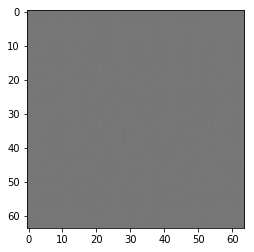

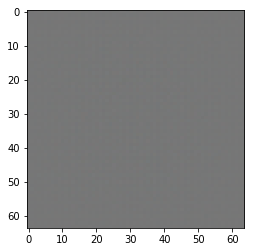

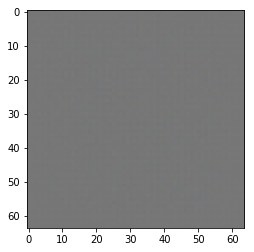

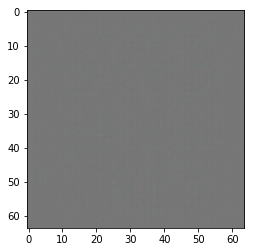

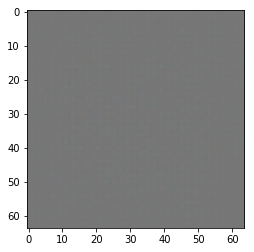

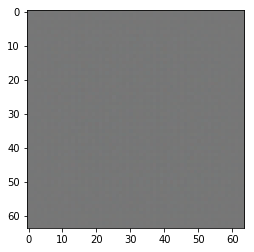

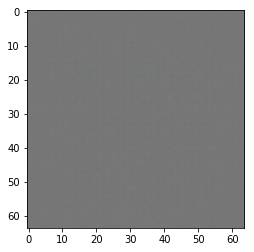

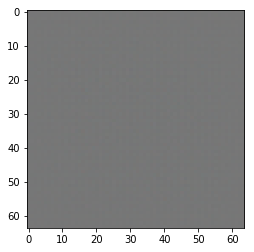

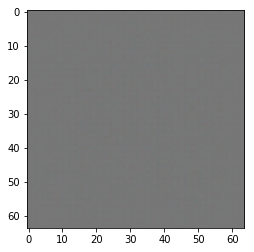

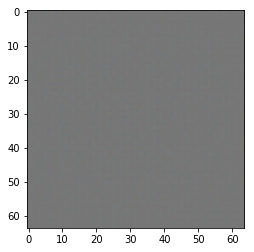

In [9]:
# This function will create a given number of images using the generator and show them

def generate_images(generator , number_of_images):
    generator.eval()
    input = torch.randn(number_of_images, z_dim , 1 , 1).cuda()
    with torch.no_grad():
        gen_image = generator.forward(input)
        gen_image = gen_image.permute([0 , 2 , 3 , 1])
        gen_image = gen_image.cpu().numpy()[: , : , : , :]
    
    for i in range(number_of_images):
        show_img( numpy_denormalize(gen_image[i]))

generate_images(generator , 10)

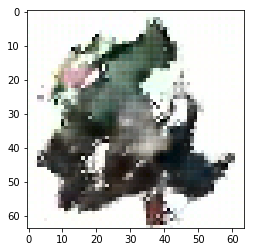

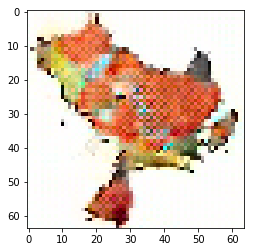

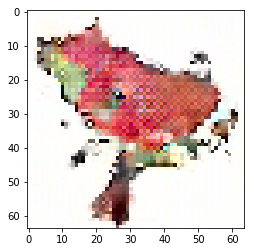

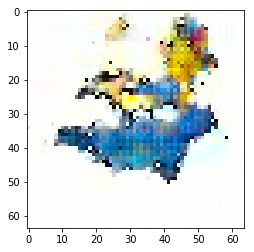

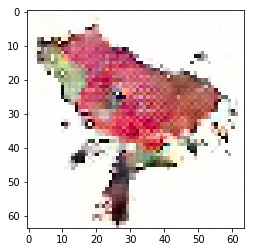

...

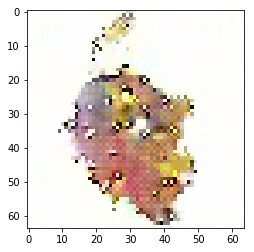

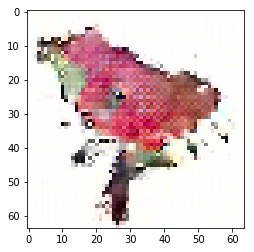

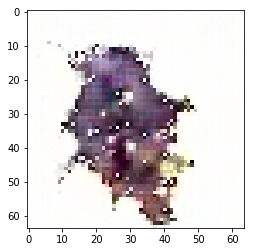

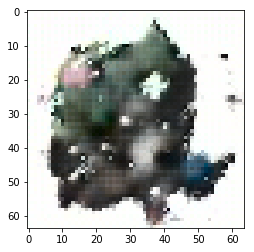

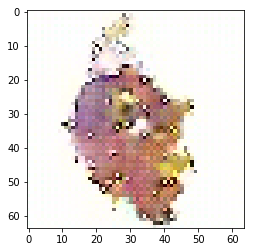

epoch :  86010
gloss :  19.179533004760742
dloss :  5.4882981203263626e-05
epoch :  86040
gloss :  20.268131256103516
dloss :  0.0005891394102945924
epoch :  86070
gloss :  12.06192398071289
dloss :  0.0028543774969875813
epoch :  86100
gloss :  7.825230121612549
dloss :  0.007606239523738623
epoch :  86130
gloss :  37.9820556640625
dloss :  9.400627459399402e-05
epoch :  86160
gloss :  25.805259704589844
dloss :  0.00011896638898178935
epoch :  86190
gloss :  23.987552642822266
dloss :  0.0011345745297148824
epoch :  86220
gloss :  19.695995330810547
dloss :  0.0004447044339030981
epoch :  86250
gloss :  13.893548965454102
dloss :  0.00042006108560599387
epoch :  86280
gloss :  14.423013687133789
dloss :  0.0008032621117308736
epoch :  86310
gloss :  10.788657188415527
dloss :  0.0019940375350415707
epoch :  86340
gloss :  9.968497276306152
dloss :  0.0007393466657958925
epoch :  86370
gloss :  8.200233459472656
dloss :  0.00048282480565831065
epoch :  86400
gloss :  5.923863410949707

KeyboardInterrupt: 

In [10]:
from IPython.display import clear_output
import time

#Now let's train the model !!
for epoch in range(epochs):
    gen_dataset = []
    
    ######### TRAIN THE GENERATOR ##################
    
    generator.train()
    for gen_epoch in range(gen_epochs):
        # reset the gradient through the generator
        gen_optimizer.zero_grad()
        
        # Create the noises which will be the input of the generator
        inputs = torch.randn(mini_batch_size, z_dim , 1 , 1).cuda().float()
        # Let's generate the images
        gen_image = generator.forward(inputs)
        # We discriminator will evaluate the generator
        image_eval = discriminator.forward(gen_image)
        # Let's create the label of our data which is 1 
        # since we want the generator to learn to deceive the discriminator
        labels = torch.full((mini_batch_size , 1) , real_label).cuda().float()
        # Compute the loss
        gloss = criterion(image_eval , labels)
        # Backprop the loss
        gloss.backward()
    
    # train the generator    
    gen_optimizer.step()
        
    ##################################################
        
    ######### TRAIN THE DISCRIMINATOR ################
    
    discriminator.train()
    
    #reset the gradients
    gen_optimizer.zero_grad()
    disc_optimizer.zero_grad()
    
    # Generate the noise for the generator
    fake_inputs = torch.randn(mini_batch_size, z_dim , 1 , 1).cuda().float()
    # Create our fake images 
    fake_inputs = generator(fake_inputs)
    # Create the associated labels
    fake_labels = torch.full((mini_batch_size , 1) , fake_label).cuda().float()
    
    # Compute the discriminator prediction over our our fake images (real vs false) 
    outputs = discriminator.forward(fake_inputs)
    # Compute the associated loss
    dloss = criterion(outputs , fake_labels)
    # Backprop the loss
    dloss.backward()
    
    # Pick some samples from the dataset
    real_inputs = torch.from_numpy( data[np.random.choice(data.shape[0], mini_batch_size) , : , : , :] )
    real_inputs = real_inputs.cuda().float().permute([0 , 3 , 1 , 2])
    
    # Create the associated labels
    real_labels = torch.full((mini_batch_size, 1) , real_label).cuda().float()
    
    # Compute the discriminator prediction over our our real images (real vs false)
    outputs = discriminator.forward(real_inputs)
    # Compute the associated loss
    dloss = criterion(outputs , real_labels)
    # Backprop the loss
    dloss.backward()
    
    # Train the discriminator
    disc_optimizer.step()
    
    
    ##################################################
    
    ########### DEBUG INFO ###########################
    
    
    if epoch % 500 == 0:
        clear_output()
        generate_images(generator , 30)
        plt.show()
        
    if epoch % 30 == 0:
        print('epoch : ' , epoch)
        print('gloss : ' , gloss.item())
        print('dloss : ' , dloss.item())
        
    ##################################################
        
    

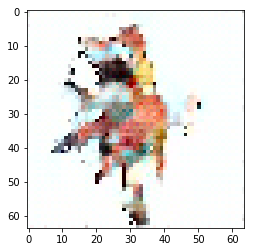

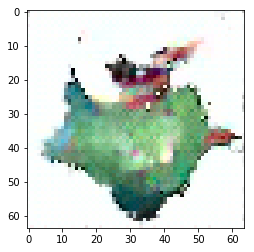

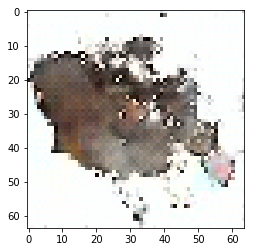

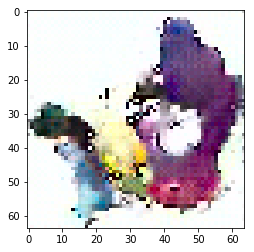

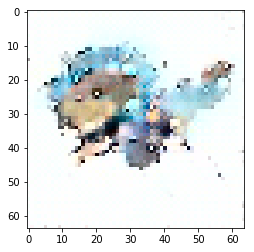

...

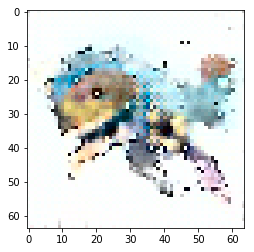

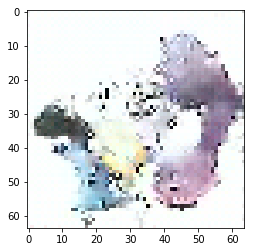

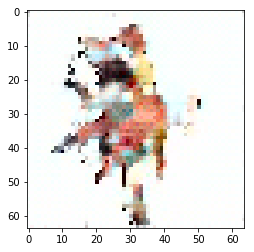

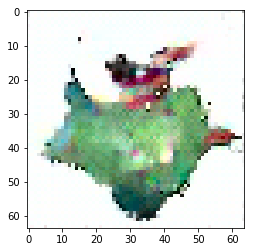

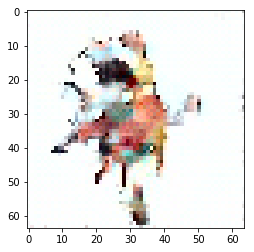

In [11]:
generate_images(generator , 1000)